<a href="https://colab.research.google.com/github/PilliChandu/Test-Driving-car/blob/main/DRIVING133.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
!pip install imgaug

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 948.0/948.0 kB 17.2 MB/s eta 0:00:00


In [2]:
!git clone https://github.com/PilliChandu/Test-Driving-car

import cv2
import numpy as np
import sklearn
import matplotlib.pyplot as plt
from sklearn.utils import shuffle
from sklearn.model_selection import train_test_split
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Lambda, Conv2D, Dropout, Dense, Flatten
import os
import csv

Cloning into 'Test-Driving-car'...
remote: Enumerating objects: 8491, done.
remote: Counting objects: 100% (4/4), done.
remote: Compressing objects: 100% (4/4), done.
remote: Total 8491 (delta 0), reused 0 (delta 0), pack-reused 8487 (from 2)
Receiving objects: 100% (8491/8491), 119.74 MiB | 33.81 MiB/s, done.


In [3]:
def generator(samples, batch_size=32):
    num_samples = len(samples)
    while True:
        shuffle(samples)
        for offset in range(0, num_samples, batch_size):
            batch_samples = samples[offset:offset+batch_size]
            images = []
            angles = []
            for batch_sample in batch_samples:
                img_name = os.path.basename(batch_sample[0])
                img_path = os.path.join(data_dir, "IMG", img_name)
                if not os.path.exists(img_path):
                    continue # skip if missing
                image = cv2.imread(img_path)
                image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
                angle = float(batch_sample[3])
                images.append(image)
                angles.append(angle)
            if images: # only yield if not empty
                X_train = np.array(images)
                y_train = np.array(angles)
                yield (X_train, y_train)


data_dir = "Test-Driving-car"
csv_path = os.path.join(data_dir, "driving_log.csv")
samples = []
with open(csv_path) as csvfile:
    reader = csv.reader(csvfile)
    for line in reader:
        fixed_line = []
        for i in range(3): # center, left, right images
            # Replace backslashes with forward slashes, strip spaces
            clean_path = line[i].strip().replace("\\", "/")
            filename = os.path.basename(clean_path)
            filepath = os.path.join(data_dir, "IMG", filename)
            fixed_line.append(filepath)
        fixed_line.extend(line[3:]) # steering, throttle, brake, speed
        samples.append(fixed_line)

missing = 0
for row in samples:
    for i in range(3):
        if not os.path.exists(row[i]):
            missing += 1
print(f"Missing images: {missing} / {len(samples) * 3}")

Missing images: 3 / 8478


In [4]:
train_samples, validation_samples = train_test_split(samples, test_size=0.2)
batch_size = 32
train_generator = generator(train_samples, batch_size)
validation_generator = generator(validation_samples, batch_size)


model = Sequential()
model.add(Lambda(lambda x: x / 255.0 - 0.5, input_shape=(160, 320, 3)))
model.add(Conv2D(24, (5, 5), strides=(2, 2), activation="relu"))
model.add(Conv2D(36, (5, 5), strides=(2, 2), activation="relu"))
model.add(Conv2D(48, (5, 5), strides=(2, 2), activation="relu"))
model.add(Conv2D(64, (3, 3), activation="relu"))
model.add(Conv2D(64, (3, 3), activation="relu"))
model.add(Flatten())
model.add(Dense(100))
model.add(Dense(50))
model.add(Dense(10))
model.add(Dense(1))

model.compile(loss='mse', optimizer='adam')


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/lambda_layer.py:65: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


In [5]:
history = model.fit(
    train_generator,
    steps_per_epoch=len(train_samples)//batch_size,
    validation_data=validation_generator,
    validation_steps=len(validation_samples)//batch_size,
    epochs=5,
    verbose=1
)

model.save("model.h5")

Epoch 1/5
70/70 ━━━━━━━━━━━━━━━━━━━━ 45s 614ms/step - loss: 1.8492 - val_loss: 0.1799
Epoch 2/5
70/70 ━━━━━━━━━━━━━━━━━━━━ 43s 622ms/step - loss: 0.1602 - val_loss: 0.1899
Epoch 3/5
70/70 ━━━━━━━━━━━━━━━━━━━━ 43s 608ms/step - loss: 0.1556 - val_loss: 0.1996
Epoch 4/5
70/70 ━━━━━━━━━━━━━━━━━━━━ 42s 608ms/step - loss: 0.1544 - val_loss: 0.1871
Epoch 5/5
70/70 ━━━━━━━━━━━━━━━━━━━━ 82s 1s/step - loss: 0.1590 - val_loss: 0.1841


In [10]:
output_video = "self_driving_simulation.mp4"
fourcc = cv2.VideoWriter_fourcc(*'mp4v')
fps = 20
frame_size = (320, 160)
video_writer = cv2.VideoWriter(output_video, fourcc, fps, frame_size)

for sample in validation_samples[:2000]: # simulate first 200 frames
    image = cv2.imread(sample[0])
    image_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
    image_resized = cv2.resize(image_rgb, (320, 160))
    steering_angle = model.predict(np.expand_dims(image_resized, axis=0))[0][0]
    # (Optional) Overlay steering angle text
    display_img = image_resized.copy()
    cv2.putText(display_img, f"Steering: {steering_angle:.2f}", (10, 20),
                cv2.FONT_HERSHEY_SIMPLEX, 0.6, (255, 0, 0), 2)
    video_writer.write(cv2.cvtColor(display_img, cv2.COLOR_RGB2BGR))

video_writer.release()

print("Simulation video saved as:", output_video)

from IPython.display import Video

Video("self_driving_simuulation.mp4", embed=True)

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 44ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 72ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 36ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
1/1 ━━━━━━━━

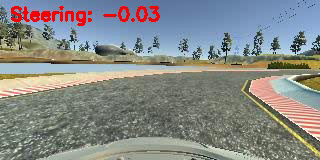

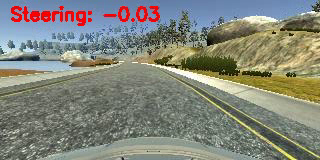

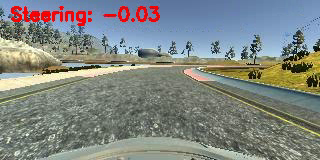

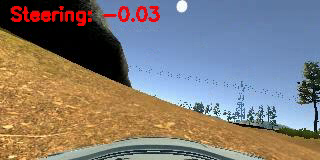

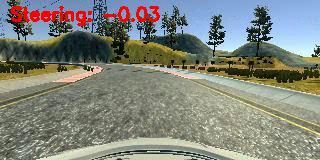

...

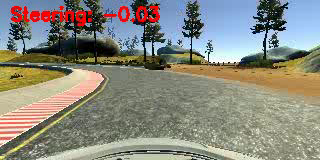

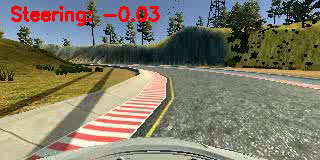

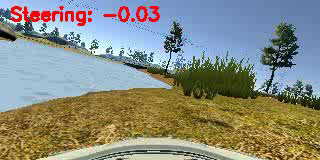

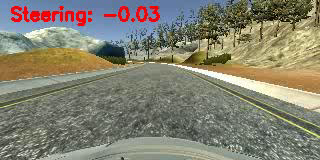

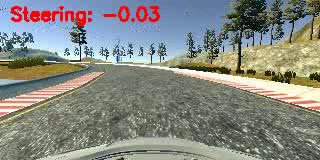

In [8]:
import cv2
from google.colab.patches import cv2_imshow

# Load video
video_path = "self_driving_simulation.mp4"
cap = cv2.VideoCapture(video_path)

# Get FPS of the video
fps = int(cap.get(cv2.CAP_PROP_FPS))

while cap.isOpened():
    ret, frame = cap.read()
    if not ret:
        break

    cv2_imshow(frame)

    # Delay according to FPS (1/fps seconds per frame)
    if cv2.waitKey(int(1000 / fps)) & 0xFF == ord('q'):
        break

cap.release()
cv2.destroyAllWindows()